# 板情報の可視化（フル板）

```{attention} ToDo:
解説を書く
```

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

[Tardis.dev](https://docs.tardis.dev/historical-data-details/coinbase#downloadable-csv-files) よりフル板のCSVをダウンロードして読み込みます。

```python
df = pd.read_csv("coinbase_incremental_book_L2_2019-07-01_BTC-USD.csv.gz", nrows=100000)
df.to_pickle("coinbase_incremental_book_L2_2019-07-01_BTC-USD.pickle", protocol=4)
```

```{attention}
実際には上記のコードで取得しますが、ここでは取得済みのpickleファイルから読み込みます。
```

In [2]:
df = pd.read_pickle("coinbase_incremental_book_L2_2019-07-01_BTC-USD.pickle")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   exchange         100000 non-null  object 
 1   symbol           100000 non-null  object 
 2   timestamp        100000 non-null  int64  
 3   local_timestamp  100000 non-null  int64  
 4   is_snapshot      100000 non-null  bool   
 5   side             100000 non-null  object 
 6   price            100000 non-null  float64
 7   amount           100000 non-null  float64
dtypes: bool(1), float64(2), int64(2), object(3)
memory usage: 5.4+ MB


In [4]:
df.loc[:, "timestamp"] = pd.to_datetime(df.loc[:, "timestamp"], unit="us")
df.loc[:, "local_timestamp"] = pd.to_datetime(df.loc[:, "local_timestamp"], unit="us")
df.sort_values("timestamp", inplace=True)
df.set_index("timestamp", drop=False, inplace=True)
df.index.name = None
# amount=0を欠損値とする
df.loc[df.loc[:, "amount"] == 0, "amount"] = np.nan

In [5]:
df.head()

,exchange,symbol,timestamp,local_timestamp,is_snapshot,side,price,amount
2019-07-01 00:00:00.923,coinbase,BTC-USD,2019-07-01 00:00:00.923,2019-07-01 00:00:01.444699,False,bid,10751.56,5.345
2019-07-01 00:00:00.924,coinbase,BTC-USD,2019-07-01 00:00:00.924,2019-07-01 00:00:01.444749,False,bid,10751.56,1.000
2019-07-01 00:00:00.926,coinbase,BTC-USD,2019-07-01 00:00:00.926,2019-07-01 00:00:01.444836,False,ask,10775.89,NaN
2019-07-01 00:00:00.926,coinbase,BTC-USD,2019-07-01 00:00:00.926,2019-07-01 00:00:01.444908,False,bid,10733.75,NaN
2019-07-01 00:00:00.926,coinbase,BTC-USD,2019-07-01 00:00:00.926,2019-07-01 00:00:01.444922,False,bid,10735.06,NaN


## 外れ値の確認

In [6]:
df.describe()

,price,amount
count,1.000000e+05,7.220700e+04
mean,1.334097e+05,3.626727e+00
std,2.695268e+07,1.442468e+02
min,1.000000e-02,4.000000e-08
25%,1.068040e+04,1.367835e-01
50%,1.072972e+04,7.000000e-01
75%,1.075993e+04,1.431781e+00
max,8.385506e+09,2.961931e+04


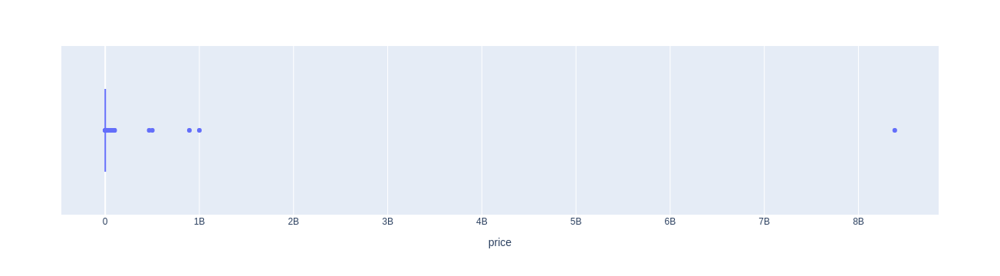

In [7]:
px.box(df, x="price")

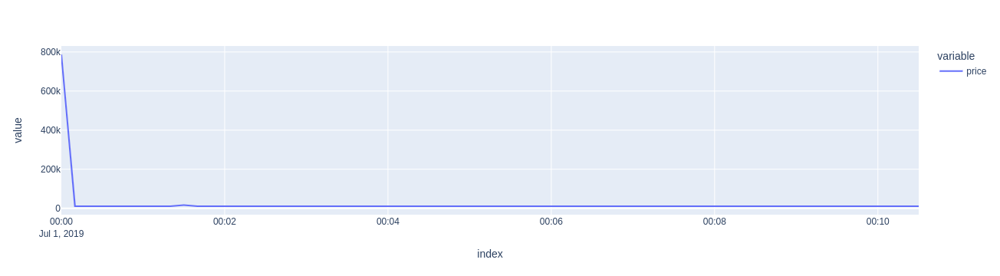

In [8]:
px.line(df.loc[:, "price"].resample("10s").mean())

前半のデータに外れ値があるため、除外します。

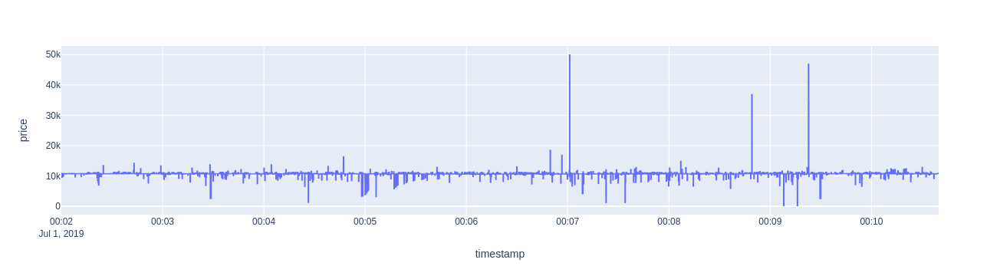

In [9]:
cut_df = df.loc["2019-07-01 00:02":, :]
px.line(cut_df, x="timestamp", y="price")

四分位値を算出して、外れ値を除外します。

In [10]:
lower, upper = cut_df.loc[:, "price"].quantile((0.005, 0.99))
filtered_df = cut_df.loc[
    (cut_df.loc[:, "price"] > lower) & (cut_df.loc[:, "price"] < upper)
]

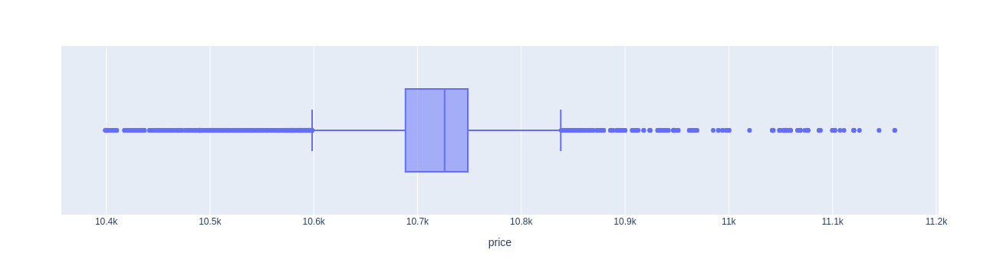

In [11]:
px.box(filtered_df, x="price")

In [12]:
df.describe()

,price,amount
count,1.000000e+05,7.220700e+04
mean,1.334097e+05,3.626727e+00
std,2.695268e+07,1.442468e+02
min,1.000000e-02,4.000000e-08
25%,1.068040e+04,1.367835e-01
50%,1.072972e+04,7.000000e-01
75%,1.075993e+04,1.431781e+00
max,8.385506e+09,2.961931e+04


散布図に可視化します。

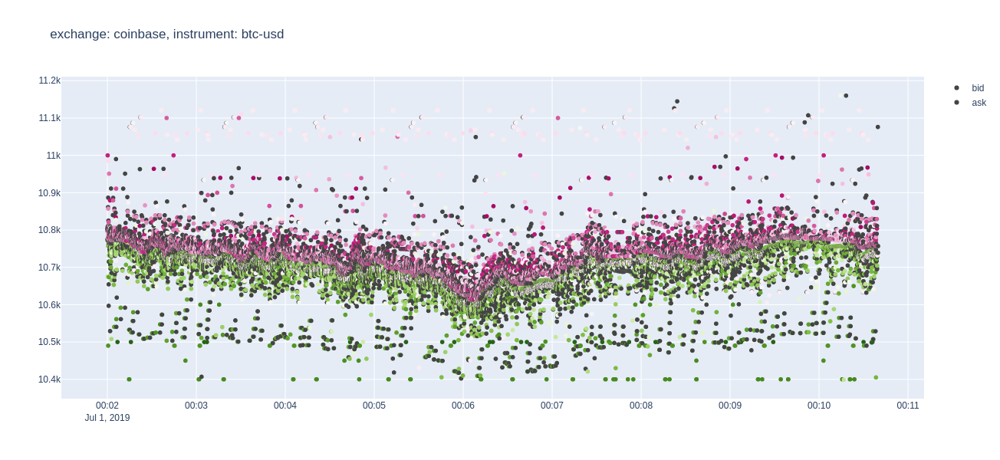

In [13]:
side = filtered_df.groupby("side")
bid, ask = side.get_group("bid"), side.get_group("ask")

fig = go.Figure(
    [
        go.Scattergl(
            mode="markers",
            x=bid.loc[:, "timestamp"],
            y=bid.loc[:, "price"],
            name="bid",
            marker={
                "color": np.log(bid.loc[:, "amount"]),
                # "colorscale": "Blues",
            },
        ),
        go.Scattergl(
            mode="markers",
            x=ask.loc[:, "timestamp"],
            y=ask.loc[:, "price"],
            name="ask",
            marker={
                "color": -np.log(ask.loc[:, "amount"]),
                # "colorscale": "Reds",
            },
        ),
    ],
    layout=go.Layout(
        title="exchange: coinbase, instrument: btc-usd", width=1400, height=600
    ),
)
fig.show()